# Aqua / Terra MODIS NBAR Time Series via Sentinel-Hub Process API

### _Import functional dependencies and add repository source directory to system path_

In [1]:
import os
import yaml
from munch import munchify

In [2]:
# define repo name and get root working directory
repo = 'process'
root_path = os.getcwd()[ 0 : os.getcwd().find( repo ) + len ( repo )]
root_path

'C:\\Users\\crwil\\Documents\\GitHub\\sentinelhub\\apis\\process'

In [3]:
# get path to configuration files
cfg_path = os.path.join( root_path, 'cfg' )
cfg_path = os.path.join( cfg_path, 'modis' )
cfg_path

'C:\\Users\\crwil\\Documents\\GitHub\\sentinelhub\\apis\\process\\cfg\\modis'

### _Load configuration file from repository cfg sub-directory_ 

In [4]:
# get pathname to configuration file
cfg_file = os.path.join( cfg_path, 'modis-timeseries-nbar.yml' )

In [5]:
# print contents of configuration file
with open( cfg_file ) as f:
    print ( f.read() )

request:
    evalscript: |
                //VERSION=3
                function setup() {
                    return {
                        input: [{
                            bands: ["B01", "B02", "B03", "B04", "B05", "B06", "B07" ],
                            units: ["reflectance", "reflectance", "reflectance", "reflectance", "reflectance", "reflectance", "reflectance" ] 
                        }],
                        output: {
                            bands: 7,
                            sampleType: "FLOAT32"
                        }
                    };
                }
                function evaluatePixel(sample) {
                    return [sample.B01, sample.B02, sample.B03, sample.B04, sample.B05, sample.B06, sample.B07 ];
                }
    inputs:
        - collection: MODIS
responses:
    default: TIFF
aoi:
    pathname: <path-to-aoi-file>
    name: name
    distance: 500



In [6]:
# load cfg file using yaml parser
with open( cfg_file, 'r' ) as f:
    config = munchify( yaml.safe_load( f ) )

### _Define area of interest centred on the Caspian Sea_

In [7]:
# define min and max latlons
coords = 44.666016,36.333218,59.343748,47.314992
resolution = 500

In [8]:
# create instance of shclient class
from processapi import Client
client = Client( config )

In [9]:
# redefine base url for nasa / usgs datasets
client._config.sh_base_url = 'https://services-uswest2.sentinel-hub.com'
client.getDataCollections()

[<DataCollection.SENTINEL2_L1C: DataCollectionDefinition(
   api_id: sentinel-2-l1c
   catalog_id: sentinel-2-l1c
   wfs_id: DSS1
   service_url: https://services.sentinel-hub.com
   collection_type: Sentinel-2
   sensor_type: MSI
   processing_level: L1C
   bands: (Band(name='B01', units=(<Unit.REFLECTANCE: 'REFLECTANCE'>, <Unit.DN: 'DN'>), output_types=(<class 'numpy.float32'>, <class 'numpy.uint16'>)), Band(name='B02', units=(<Unit.REFLECTANCE: 'REFLECTANCE'>, <Unit.DN: 'DN'>), output_types=(<class 'numpy.float32'>, <class 'numpy.uint16'>)), Band(name='B03', units=(<Unit.REFLECTANCE: 'REFLECTANCE'>, <Unit.DN: 'DN'>), output_types=(<class 'numpy.float32'>, <class 'numpy.uint16'>)), Band(name='B04', units=(<Unit.REFLECTANCE: 'REFLECTANCE'>, <Unit.DN: 'DN'>), output_types=(<class 'numpy.float32'>, <class 'numpy.uint16'>)), Band(name='B05', units=(<Unit.REFLECTANCE: 'REFLECTANCE'>, <Unit.DN: 'DN'>), output_types=(<class 'numpy.float32'>, <class 'numpy.uint16'>)), Band(name='B06', units=

In [10]:
# get utm bbox
bbox = Client.getBoundingBox( coords )
print ( bbox, bbox.crs.value )

-68802.6054958601,4039580.0442555356,1130416.3144492358,5274026.951890117 32639


In [11]:
# get aoi image dimensions
Client.getBoxDimensions( bbox, resolution )

(2398, 2469)

### _Use Catalog API to locate MODIS scene acquired on August 2020_

In [12]:
# define aggregation timeframe
from datetime import datetime
timeframe = { 'start' : datetime.strptime('2020-08-10', '%Y-%m-%d'), 'end' : datetime.strptime('2020-08-11', '%Y-%m-%d') }

In [13]:
# get scenes from catalogue
client.getDatasetTimeStamps( config.request.inputs[ 0 ], timeframe, bbox=bbox  )

[datetime.datetime(2020, 8, 10, 12, 0, tzinfo=tzutc())]

### _Download MODIS NBAR channel data via Process API client_

In [14]:
client.getRequest( timeframe, resolution, bbox=bbox ).payload

{'input': {'bounds': {'properties': {'crs': 'http://www.opengis.net/def/crs/EPSG/0/32639'},
   'bbox': [-68802.6054958601,
    4039580.0442555356,
    1130416.3144492358,
    5274026.951890117]},
  'data': [InputDataDict({'type': 'modis', 'dataFilter': {'timeRange': {'from': '2020-08-10T00:00:00Z', 'to': '2020-08-11T00:00:00Z'}, 'mosaickingOrder': 'mostRecent'}}, service_url=https://services-uswest2.sentinel-hub.com)]},
 'evalscript': '//VERSION=3\nfunction setup() {\n    return {\n        input: [{\n            bands: ["B01", "B02", "B03", "B04", "B05", "B06", "B07" ],\n            units: ["reflectance", "reflectance", "reflectance", "reflectance", "reflectance", "reflectance", "reflectance" ] \n        }],\n        output: {\n            bands: 7,\n            sampleType: "FLOAT32"\n        }\n    };\n}\nfunction evaluatePixel(sample) {\n    return [sample.B01, sample.B02, sample.B03, sample.B04, sample.B05, sample.B06, sample.B07 ];\n}\n',
 'output': {'responses': [{'identifier': 'd

In [15]:
# get mosaic between timeframe at specified pixel resolution
response = client.getTimeSeries( timeframe, resolution, bbox=bbox )
response._df

,default,time
0,"[[[0.1408, 0.2126, 0.0664, 0.1007, 0.2954, 0.3...",2020-08-10 12:00:00+00:00


### _Visualise NBAR channel imagery with high reflectances (cloud) masked as no data_

In [16]:
import numpy as np

# get top row data
response._df[ 'mask-default'] = response._df[ 'default' ].apply( lambda x: np.ma.masked_where( x > 0.8, x ) )
data = response._df.iloc[ 0 ][ 'mask-default' ]

# 7 band output image !
height, width, channels = data.shape
height, width, channels

(2469, 2398, 7)

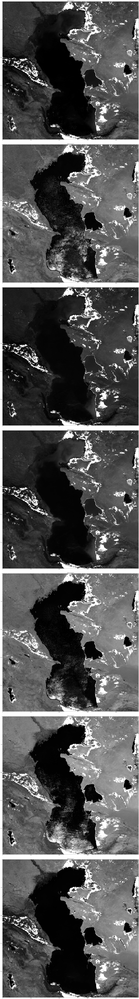

In [17]:
import matplotlib.pyplot as plt

# compute figure size
dpi = 80; border = 1
figsize = ( width + 2 * border) / float(dpi), ( ( height + 2 * border ) * channels ) / float(dpi)

# create figure and grid
fig, axes = plt.subplots(   figsize=figsize, 
                            nrows=channels, 
                            ncols=1, 
                            constrained_layout=True )

# iterate through channels
for idx in range( 0, channels ):

    # plot channel image
    axes[ idx ].set_title( f'MODIS Channel {idx+1}' )
    axes[ idx ].imshow( data[ :, :, idx ], 
                            interpolation='nearest', 
                            aspect='auto', 
                            cmap='gray' )    